# Mounting Google Drive
This project is done entirely on Google Colab using the free T4 GPU

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!ls

drive  sample_data


# Libraries and models

In [3]:
# imports
import torch
import torchvision.transforms as transforms
from PIL import Image
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim
from torchvision.utils import save_image

In [4]:
# check if your device is cuda-enabled
device = ""
if torch.cuda.is_available():
  device = torch.device("cuda")
  print("using cuda")
else:
  device = torch.device("cpu")
  print("using cpu")

using cuda


In [5]:
# use any CNN model here
# I am using a pre-trained model due to lack of time
model = models.vgg19(weights = 'IMAGENET1K_V1').features
model

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:09<00:00, 63.5MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

# Image pre-processing and loading

In [6]:
def load(path_to_image):
  image = Image.open(path_to_image)
  loader = transforms.Compose([transforms.Resize((512, 512)), transforms.ToTensor()])
  image = loader(image).unsqueeze(0)
  return image

In [55]:
# different styles
style1 = load('./drive/My Drive/Colab Notebooks/style1.jpg').to(device, torch.float)
style2 = load('./drive/My Drive/Colab Notebooks/style2.jpg').to(device, torch.float)
style3 = load('./drive/My Drive/Colab Notebooks/style3.jpg').to(device, torch.float)
style4 = load('./drive/My Drive/Colab Notebooks/style4.jpg').to(device, torch.float)
style5 = load('./drive/My Drive/Colab Notebooks/style5.jpg').to(device, torch.float)
manga = load('./drive/My Drive/Colab Notebooks/manga.jpeg').to(device, torch.float)
manhwa = load('./drive/My Drive/Colab Notebooks/manhwa.jpg').to(device, torch.float)

In [56]:
# images that will be recreated in different styles
pic1 = load('./drive/My Drive/Colab Notebooks/pearl.jpg').to(device, torch.float)
pic2 = load('./drive/My Drive/Colab Notebooks/TheSwing.jpg').to(device, torch.float)
pic3 = load('./drive/My Drive/Colab Notebooks/MonaLisa.jpg').to(device, torch.float)
pic4 = load('./drive/My Drive/Colab Notebooks/Sketch1.jpeg').to(device, torch.float)
pic5 = load('./drive/My Drive/Colab Notebooks/Sketch2.jpg').to(device, torch.float)
pic6 = load('./drive/My Drive/Colab Notebooks/Sketch3.jpg').to(device, torch.float)

In [9]:
transform = transforms.ToPILImage()

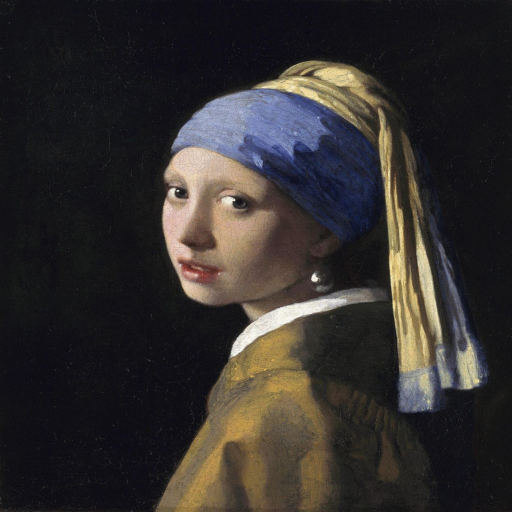

In [10]:
transform(pic1[0])

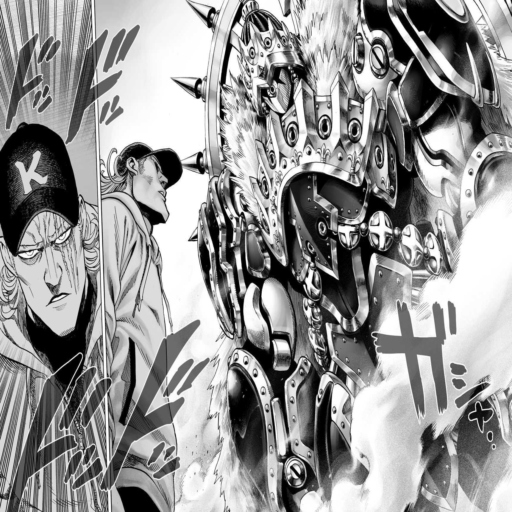

In [57]:
transform(manga[0])

In [11]:
def gen(pic):
  return pic.clone().requires_grad_(True)

In [12]:
g1 = gen(pic1)
g2 = gen(pic2)
g3 = gen(pic3)
g4 = gen(pic4)
g5 = gen(pic5)
g6 = gen(pic6)

In [13]:
g1

tensor([[[[0.0863, 0.0902, 0.0902,  ..., 0.1255, 0.1333, 0.1255],
          [0.0863, 0.1059, 0.0902,  ..., 0.1020, 0.1020, 0.1020],
          [0.0824, 0.1176, 0.1333,  ..., 0.0824, 0.0941, 0.1098],
          ...,
          [0.1412, 0.1647, 0.1608,  ..., 0.0784, 0.0745, 0.0902],
          [0.1725, 0.1569, 0.1373,  ..., 0.0902, 0.0980, 0.1020],
          [0.1961, 0.1765, 0.1686,  ..., 0.1176, 0.1216, 0.1059]],

         [[0.0863, 0.0902, 0.0902,  ..., 0.1176, 0.1255, 0.1176],
          [0.0863, 0.1059, 0.0902,  ..., 0.0941, 0.0941, 0.0941],
          [0.0824, 0.1176, 0.1333,  ..., 0.0784, 0.0902, 0.1059],
          ...,
          [0.1255, 0.1490, 0.1451,  ..., 0.0706, 0.0667, 0.0824],
          [0.1529, 0.1373, 0.1216,  ..., 0.0706, 0.0784, 0.0824],
          [0.1725, 0.1569, 0.1490,  ..., 0.1020, 0.1020, 0.0863]],

         [[0.0941, 0.0980, 0.0980,  ..., 0.1294, 0.1373, 0.1294],
          [0.0941, 0.1137, 0.0980,  ..., 0.1059, 0.1059, 0.1059],
          [0.0902, 0.1255, 0.1412,  ..., 0

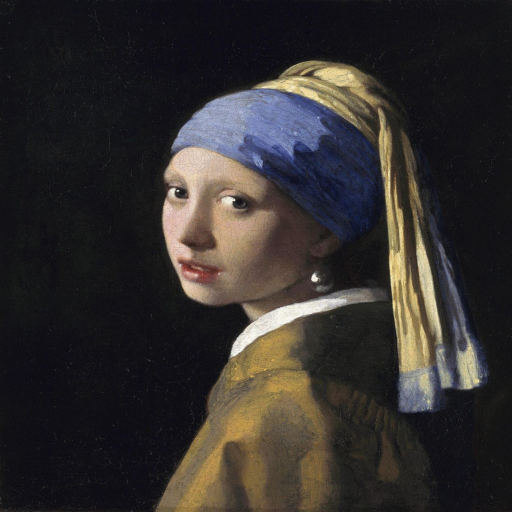

In [14]:
transform(g1[0])

# Creating the neural network

In [15]:
class cnn(nn.Module):
  def __init__(self):
    super(cnn, self).__init__()
    self.layers = ['0', '5', '10', '19', '28']
    self.model = models.vgg19(weights = 'IMAGENET1K_V1').features[0:29]
  def forward(self, x):
    layers = []
    for num, layer in enumerate(self.model):
      x = layer(x)
      if str(num) in self.layers:
        layers.append(x)
    return layers

# Defining the loss functions

Content loss is just the difference between original image and the generated/fake image

In [16]:
def content_loss(fake, original):
  return torch.mean((original - fake) ** 2)

For style loss we use the Gram matrix concept as explained in https://arxiv.org/pdf/1701.01036.pdf

In [17]:
def style_loss(fake, style):
  _, c, h, w = fake.shape
  g = torch.mm(fake.view(c, h * w), fake.view(c, h * w).t())
  a = torch.mm(style.view(c, h * w), style.view(c, h * w).t())
  return torch.mean((g - a) ** 2)

Total loss is a weighted sum of content loss and style loss

In [18]:
def loss(fake, pic, style, alpha, beta):
  cl = 0
  sl = 0
  for a, b, c in zip(fake, pic, style):
    cl = cl + content_loss(a, b)
    sl = sl + style_loss(a, c)
  return alpha*cl + beta*sl

There is no way to reliably measure the visual appeal of a style of art because that is entirely subjective

# Defining training function

In [52]:
model = cnn().to(device).eval()
final = 10000000000
def train(fake, pic, style, critical = 10000):
  global final
  final = 10000000000
  b = final
  i = 0
  while final > critical:
    # As long as loss is above a certain critical value, keep iterating
    ff = model(fake)
    pf = model(pic)
    sf = model(style)
    tl = loss(ff, pf, sf, 1, 0.01)
    optimizer = optim.Adam([fake], lr = 0.004)
    optimizer.zero_grad()
    tl.backward()
    optimizer.step()
    final = tl.item()
    if final < b:
      b = final
      # save new image if current loss is the least there has been
      save_image(fake, "fake.png")
    i += 1
    print(tl, i)
  return tl

# Trying three different art styles

In [21]:
train(g1, pic1, style1, 20000)

tensor(1341405.5000, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(1211976.1250, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(1116058.5000, device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(1040065., device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(974512.9375, device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(921588.3125, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(881452.6250, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(848907.2500, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(802484.3125, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(771094.6250, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(736995.2500, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(715160.3125, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(683634.6875, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(664385.6250, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(638801.5000, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(623349.4375, device='cuda:0', grad_fn=<Add

tensor(19869.6660, device='cuda:0', grad_fn=<AddBackward0>)

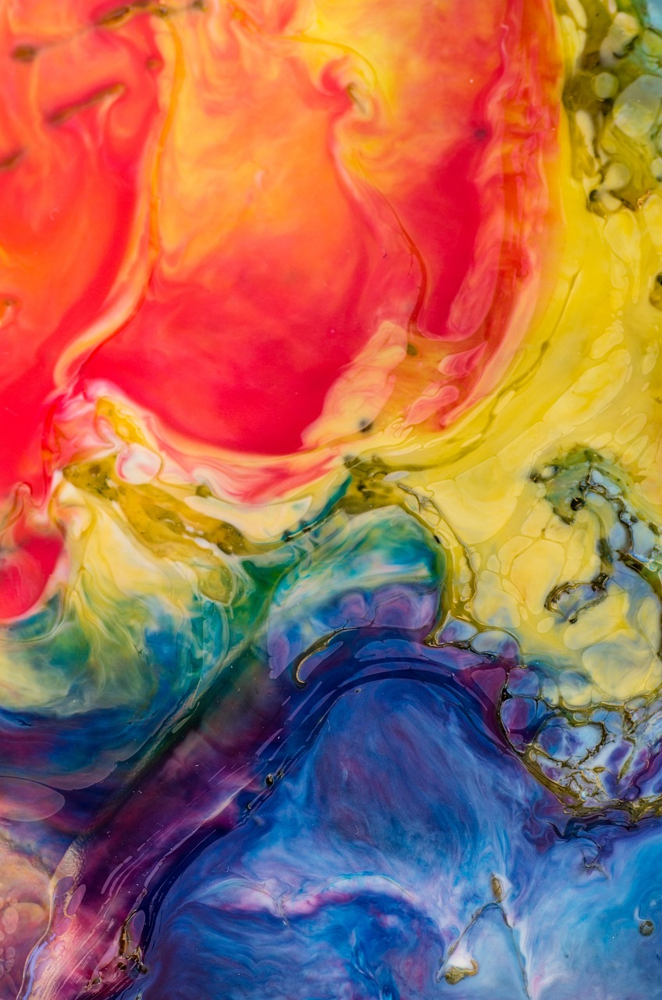

In [22]:
Image.open(r"./drive/My Drive/Colab Notebooks/style1.jpg")

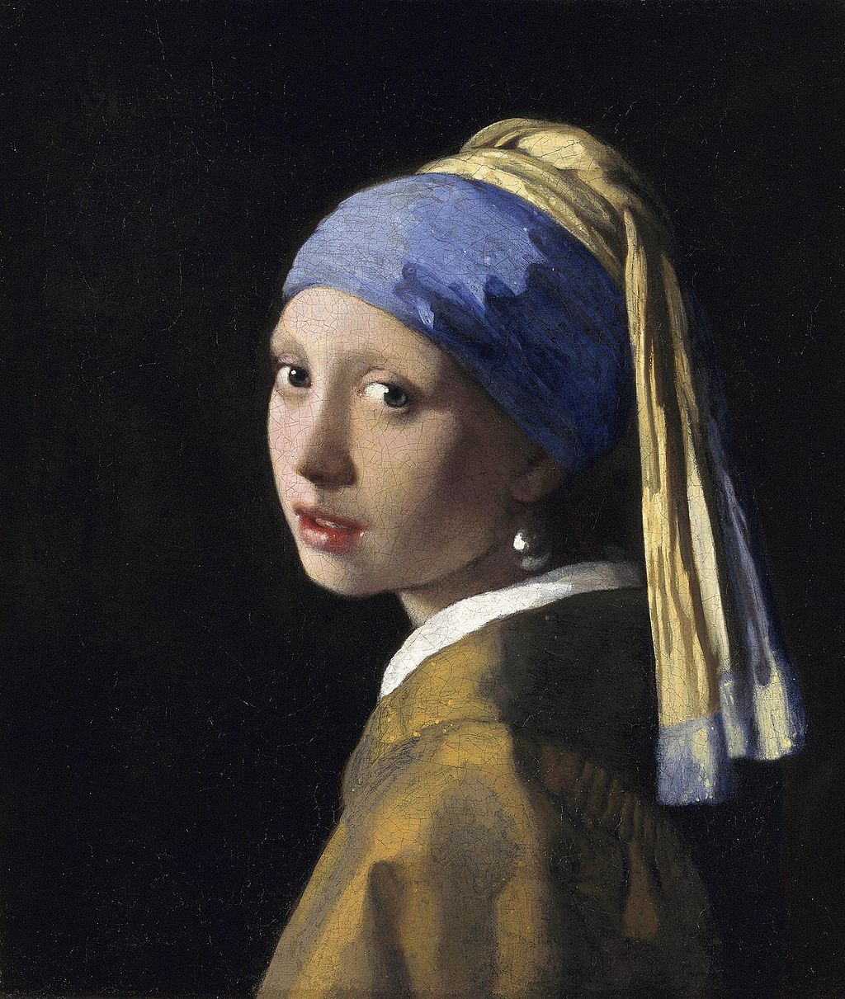

In [23]:
im = Image.open(r"./drive/My Drive/Colab Notebooks/pearl.jpg")
im

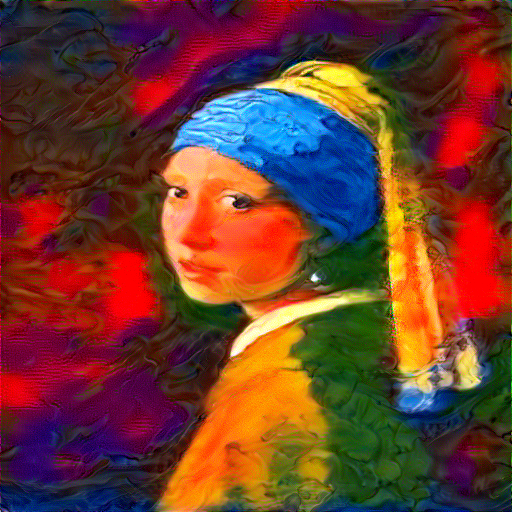

In [24]:
new = Image.open(r"fake.png")
new.resize(im.size, resample = 0)
new

In [27]:
g1 = gen(pic1)
train(g1, pic1, manga, 100000)

tensor(14350912., device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(13510690., device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(12615675., device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(11764323., device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(10993561., device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(10286000., device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(9632289., device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(9019289., device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(8449517., device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(7910697., device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(7404853., device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(6926577., device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(6481899.5000, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(6062870., device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(5671469.5000, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(5305760., device='cuda:0', grad_fn=<AddBackward0>) 16
tensor(4969537., de

tensor(98102.2188, device='cuda:0', grad_fn=<AddBackward0>)

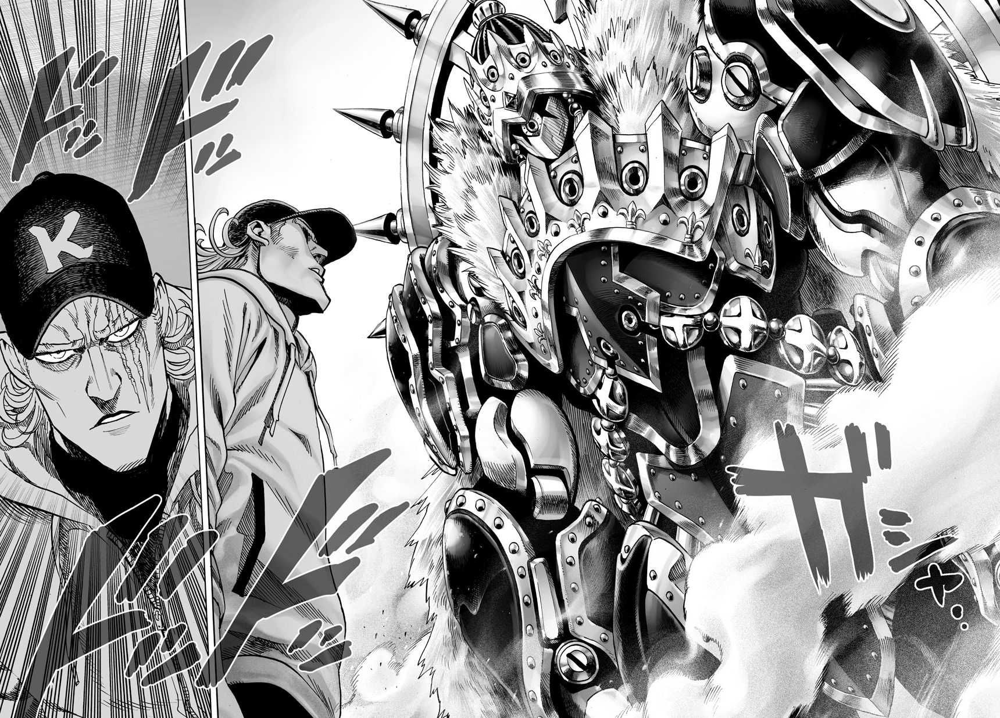

In [28]:
Image.open(r"./drive/My Drive/Colab Notebooks/manga.jpeg")

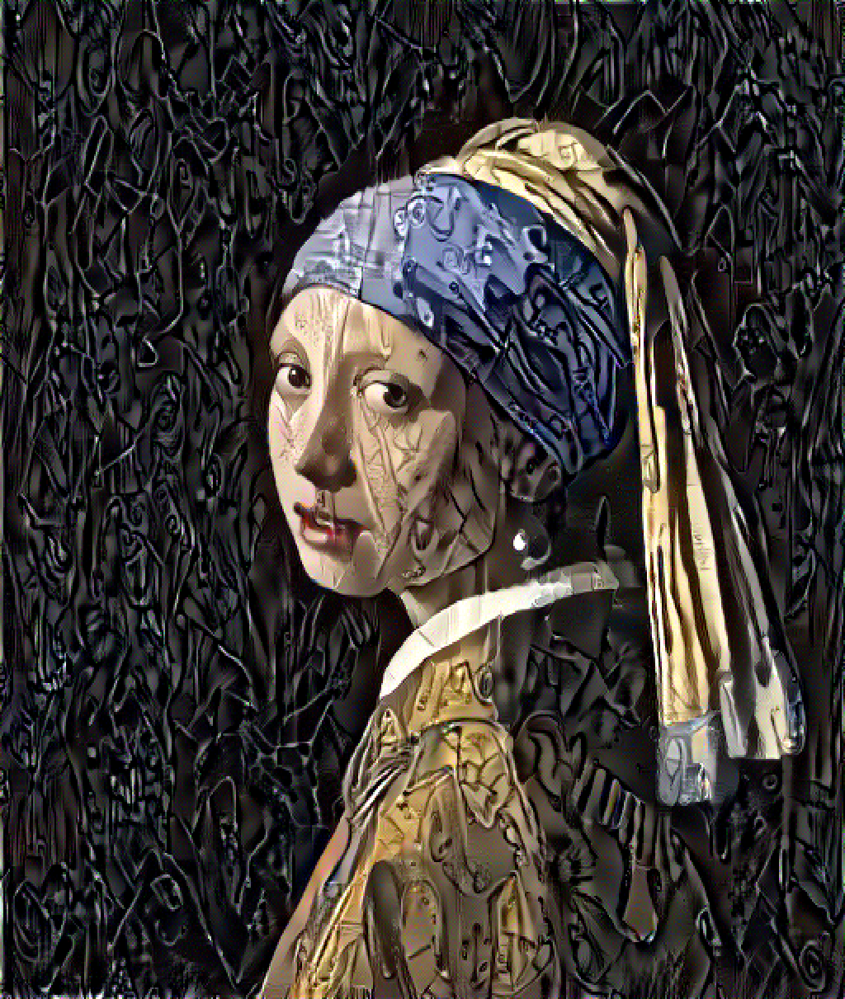

In [29]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

This has come out very disfigured compared to the previous style because of the large number of borders and complexity of the style image. We will choose a simpler style and train it less

In [30]:
g1 = gen(pic1)
train(g1, pic1, manhwa, 200000)

tensor(1775366.8750, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(1553643.7500, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(1363698.6250, device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(1203571.3750, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(1067600.1250, device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(953150.6250, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(856535.1875, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(776880.4375, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(710690.7500, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(648157.3125, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(597496.4375, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(549279.1250, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(510427.8438, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(473410.1875, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(443685.7500, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(415114.3438, device='cuda:0', grad_fn

tensor(197558.4062, device='cuda:0', grad_fn=<AddBackward0>)

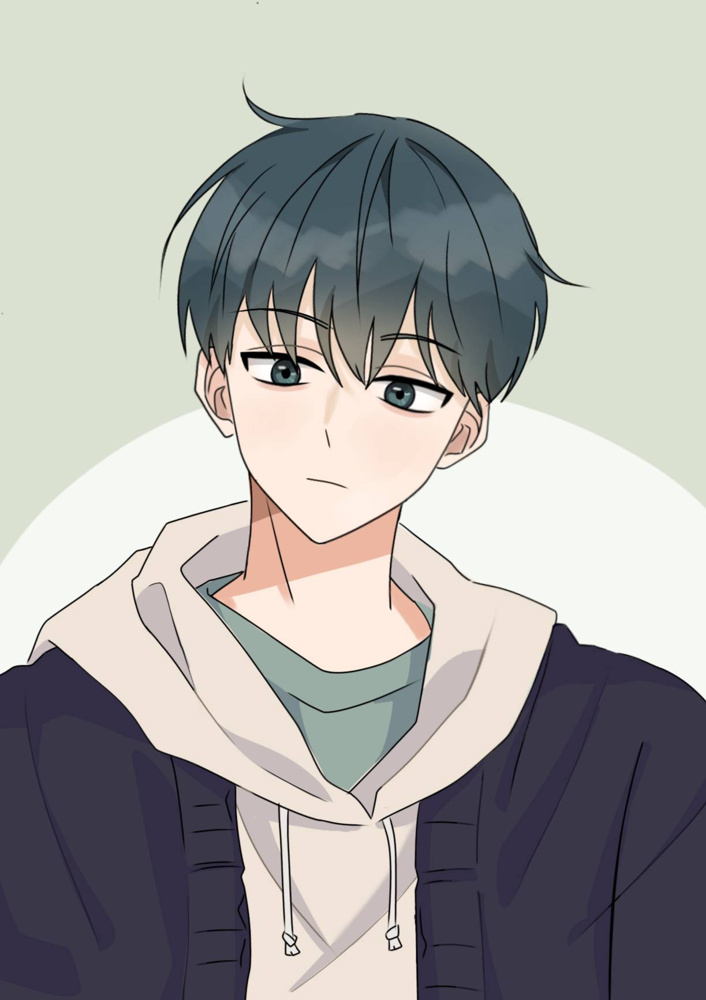

In [48]:
Image.open(r"./drive/My Drive/Colab Notebooks/manhwa.jpg")

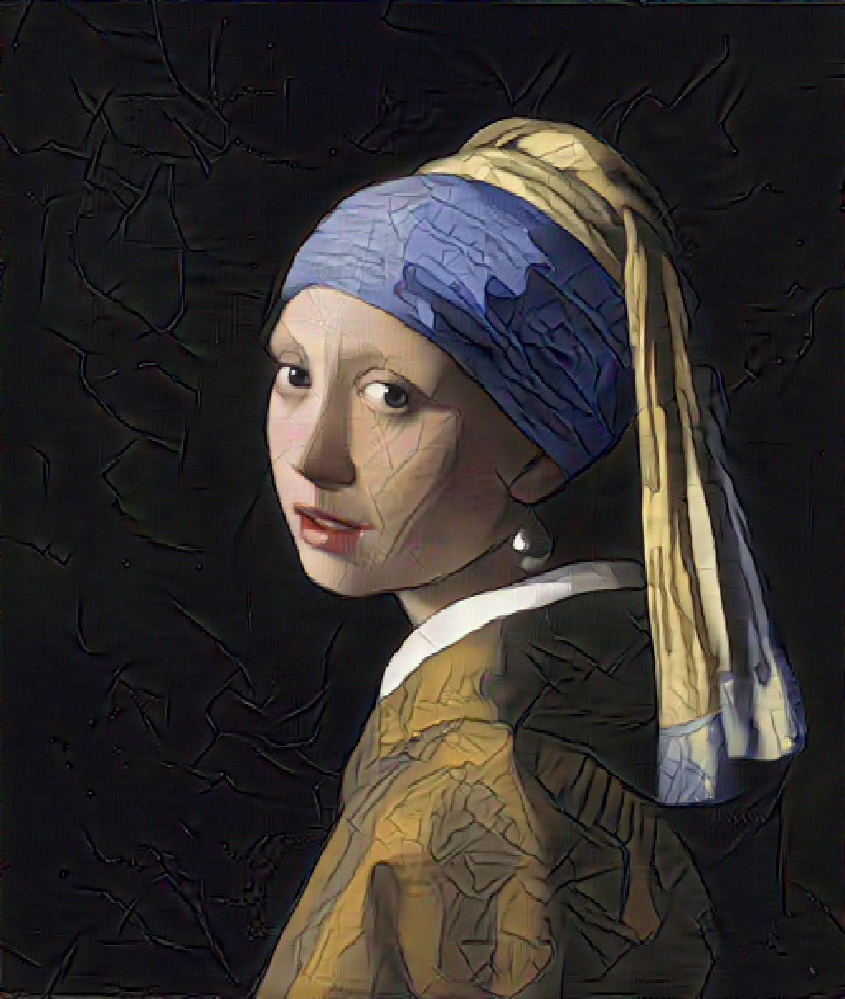

In [31]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

In [32]:
train(g3, pic3, manhwa, 200000)

tensor(1804255.7500, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(1579207.8750, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(1391611.7500, device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(1225573.2500, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(1081400., device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(958702.9375, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(855812.8125, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(770111.2500, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(693372.1250, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(630793.8125, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(573906., device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(528686.0625, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(486904.5625, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(454512.4375, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(422763.1875, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(400284.0938, device='cuda:0', grad_fn=<AddBac

tensor(196914.3125, device='cuda:0', grad_fn=<AddBackward0>)

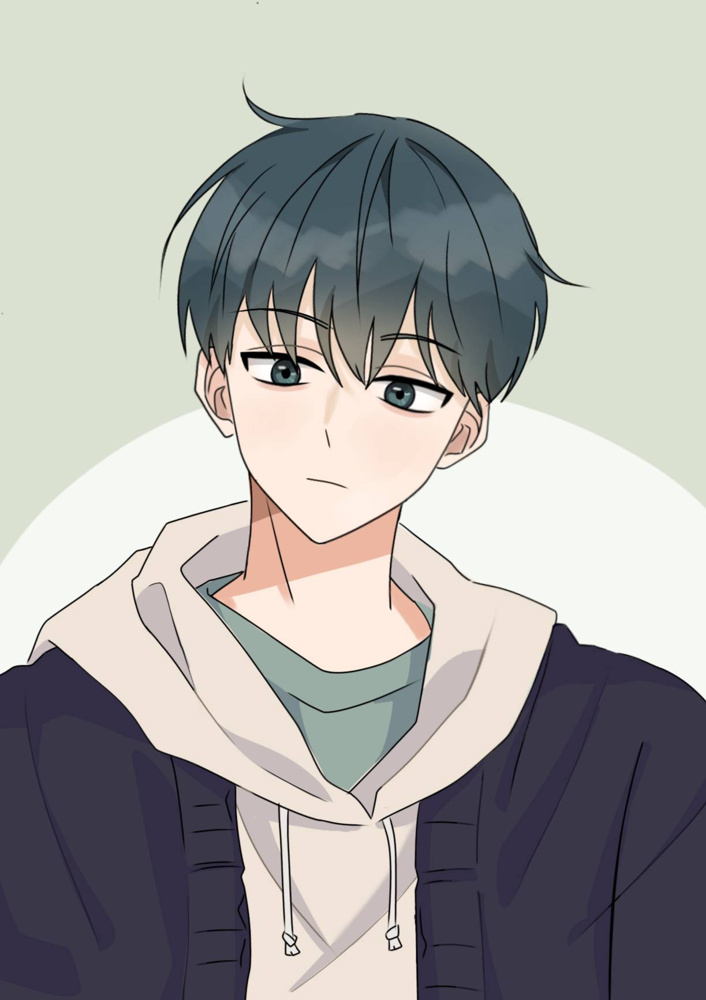

In [33]:
Image.open(r"./drive/My Drive/Colab Notebooks/manhwa.jpg")

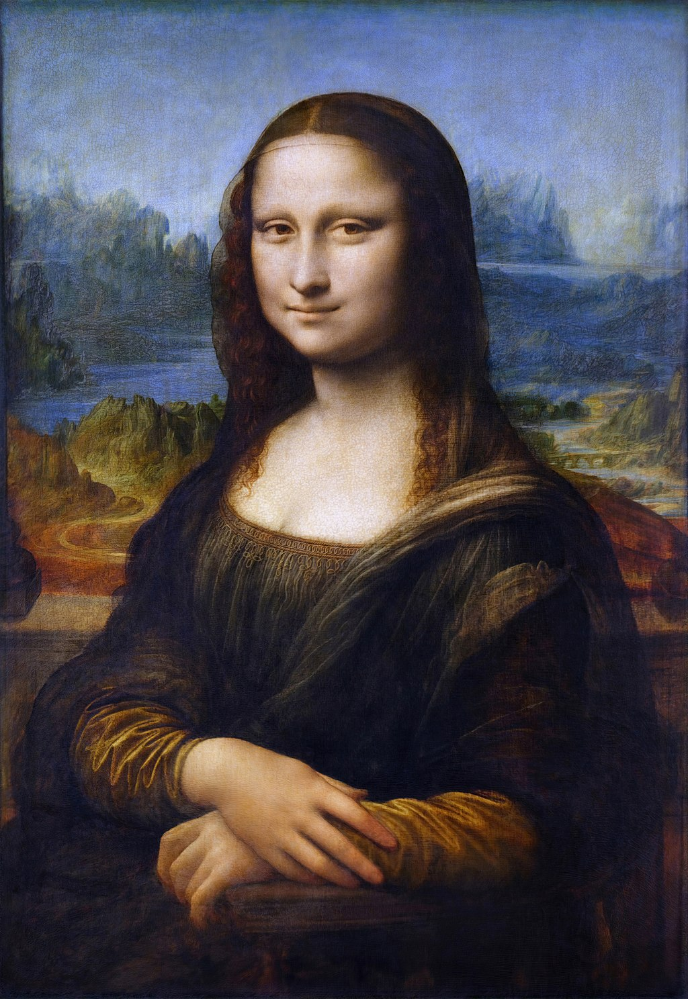

In [34]:
im = Image.open(r"./drive/My Drive/Colab Notebooks/MonaLisa.jpg")
im

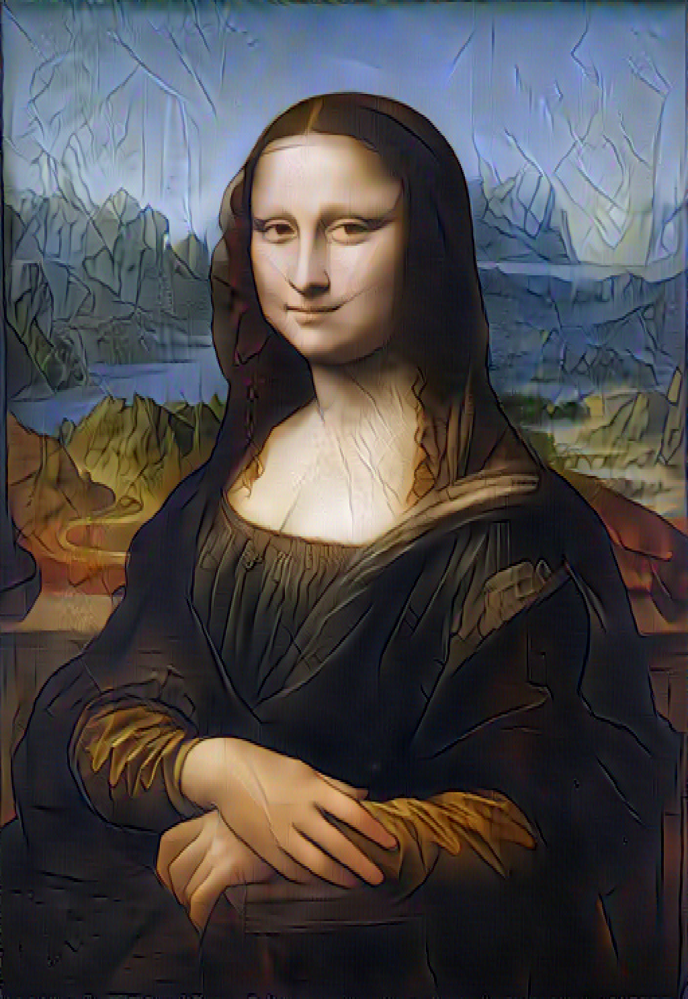

In [35]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

# Testing the transfer of five different styles onto a picture of the Mona Lisa

In [36]:
g3 = gen(pic3)
train(g3, pic3, style1, 20000)

tensor(1041682.1875, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(940534., device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(867164.5000, device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(809294.4375, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(776449.2500, device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(752833.2500, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(711096.5625, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(685031., device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(655463.6875, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(638099.3125, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(609870.0625, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(592780.1875, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(570867.8750, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(558060.2500, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(536763.6250, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(523966.9688, device='cuda:0', grad_fn=<AddBackwar

tensor(19843.6113, device='cuda:0', grad_fn=<AddBackward0>)

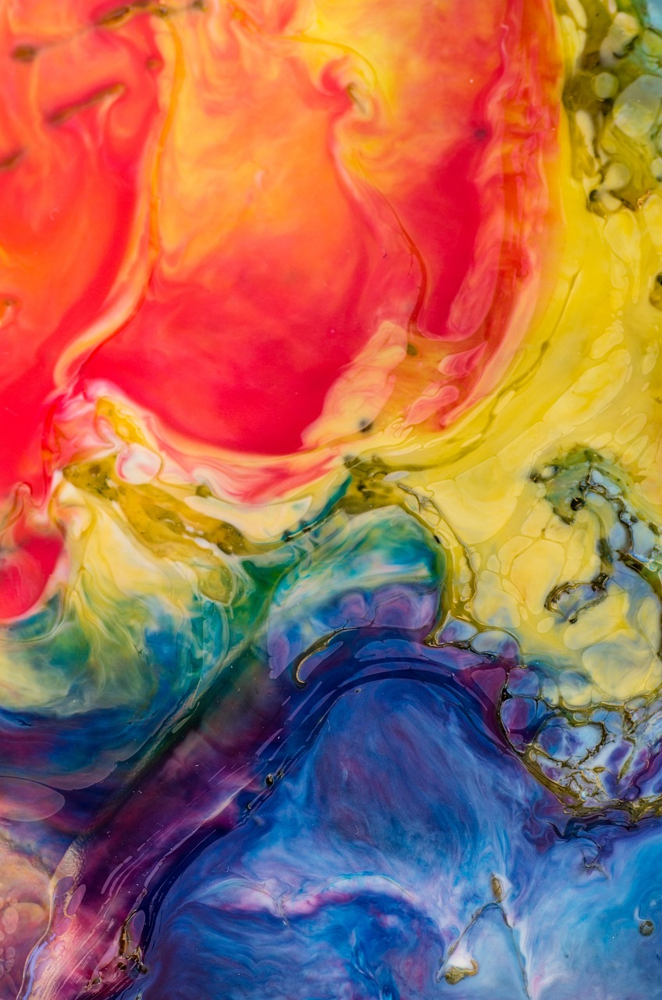

In [37]:
Image.open(r"./drive/My Drive/Colab Notebooks/style1.jpg")

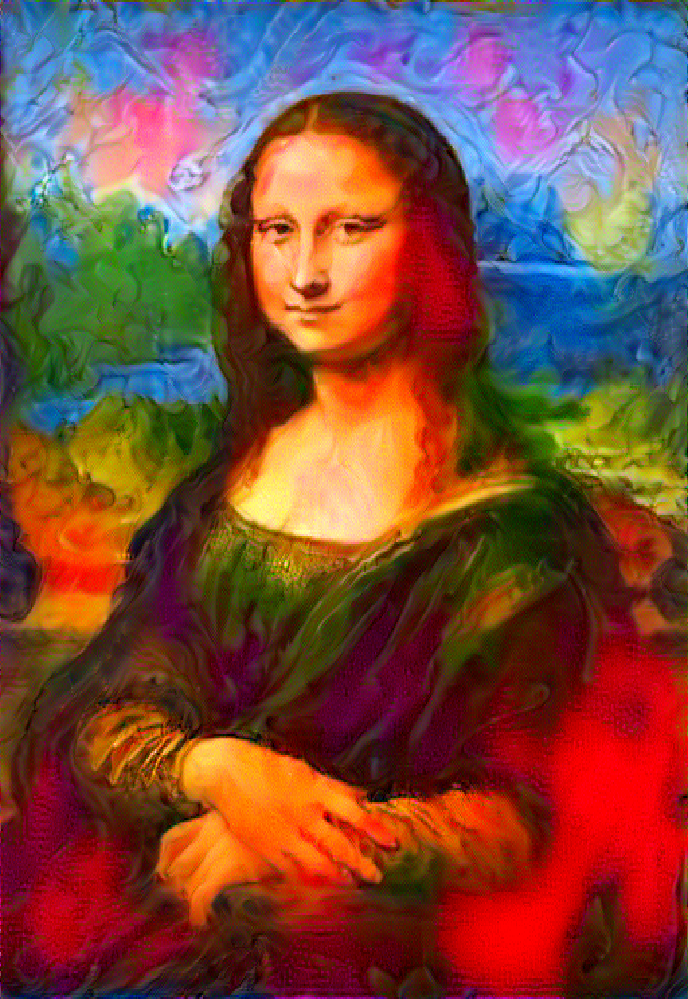

In [38]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

In [39]:
g3 = gen(pic3)
train(g3, pic3, style2, 20000)

tensor(3716874.5000, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(3378894.5000, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(3005764., device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(2642498.7500, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(2305810., device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(2001524., device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(1730471.8750, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(1489269.3750, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(1278900.8750, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(1101064.8750, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(954449.6250, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(836655.3750, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(742673.1250, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(678283.6875, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(646966.5625, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(596755.5000, device='cuda:0', grad_fn=<AddBa

tensor(19832.5547, device='cuda:0', grad_fn=<AddBackward0>)

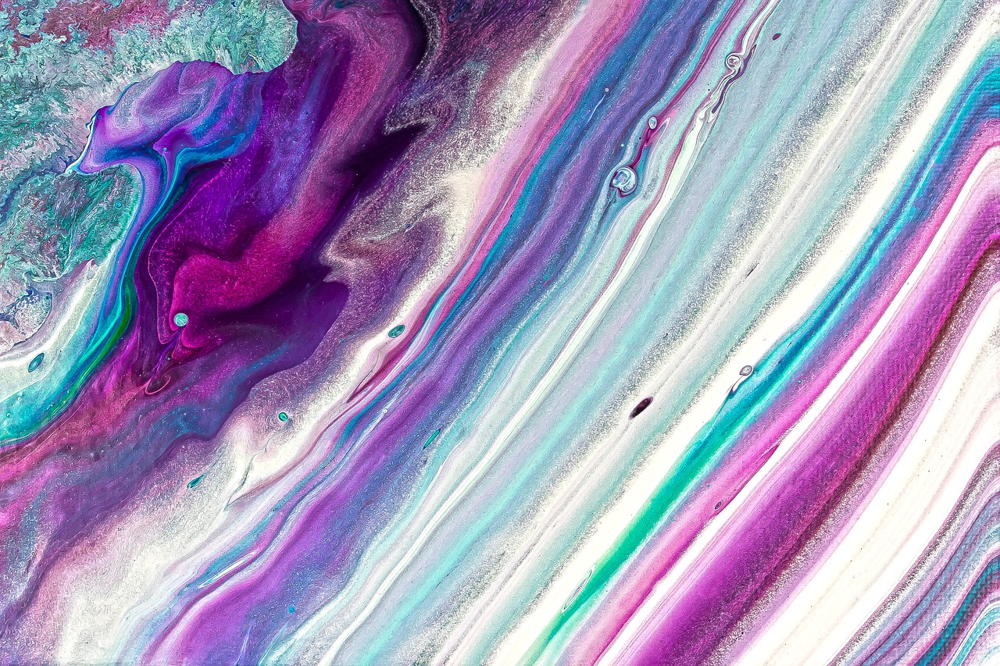

In [40]:
Image.open(r"./drive/My Drive/Colab Notebooks/style2.jpg")

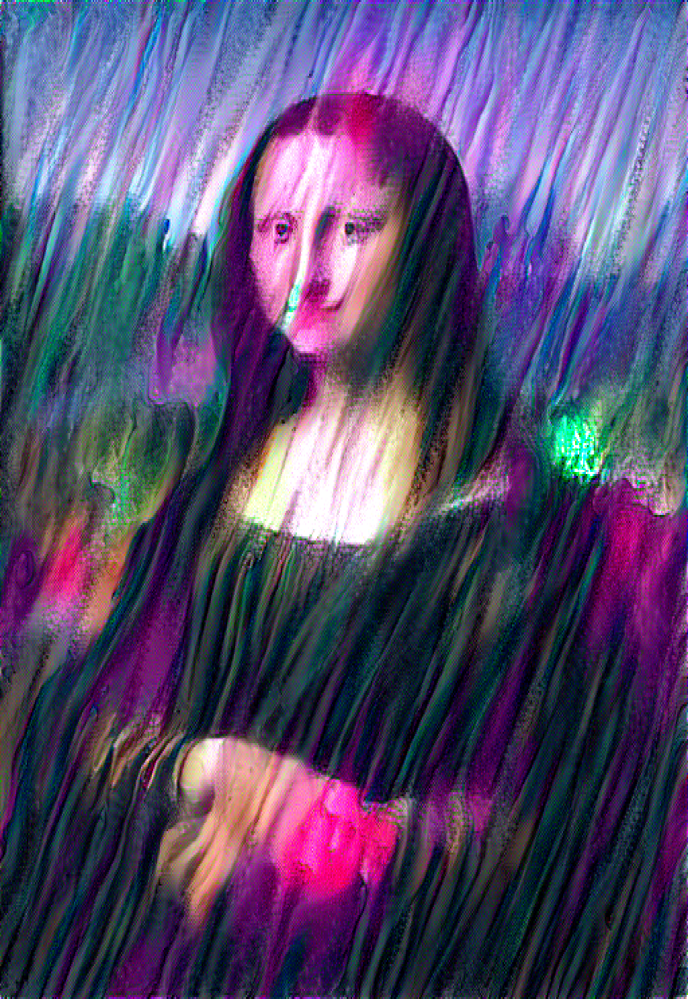

In [41]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

In [42]:
g3 = gen(pic3)
train(g3, pic3, style3, 20000)

tensor(3017651.5000, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(2764901.5000, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(2517242., device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(2291656.7500, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(2083673.2500, device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(1889747.1250, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(1709754.5000, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(1543930.1250, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(1392326.8750, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(1255037.5000, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(1131974.5000, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(1022549.1250, device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(926350.8125, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(842603.6250, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(772404.8750, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(721056.3125, device='cuda:0', grad

tensor(19835.5430, device='cuda:0', grad_fn=<AddBackward0>)

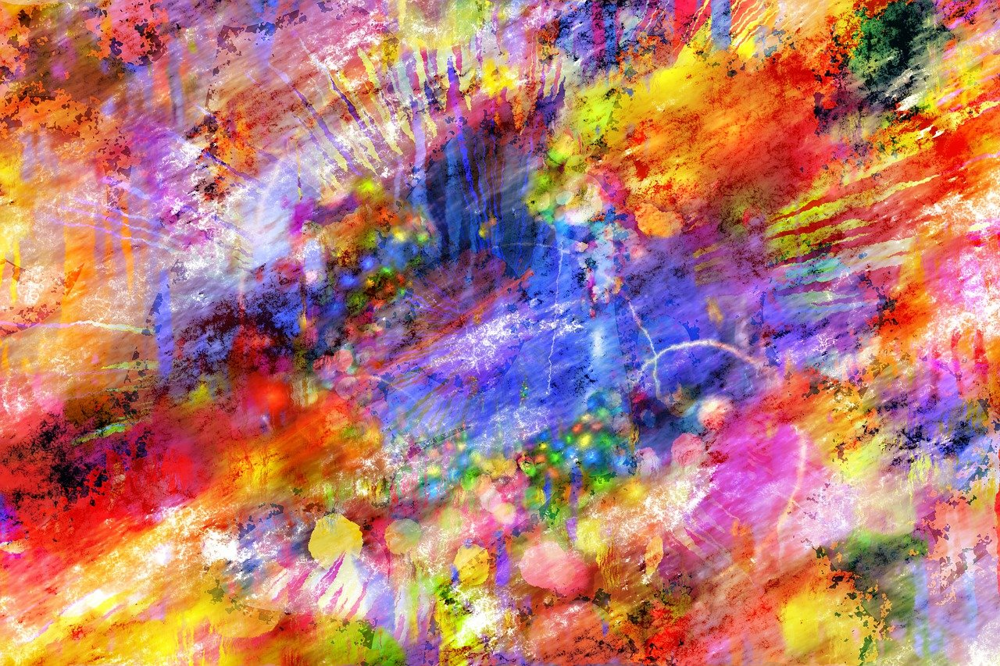

In [43]:
Image.open(r"./drive/My Drive/Colab Notebooks/style3.jpg")

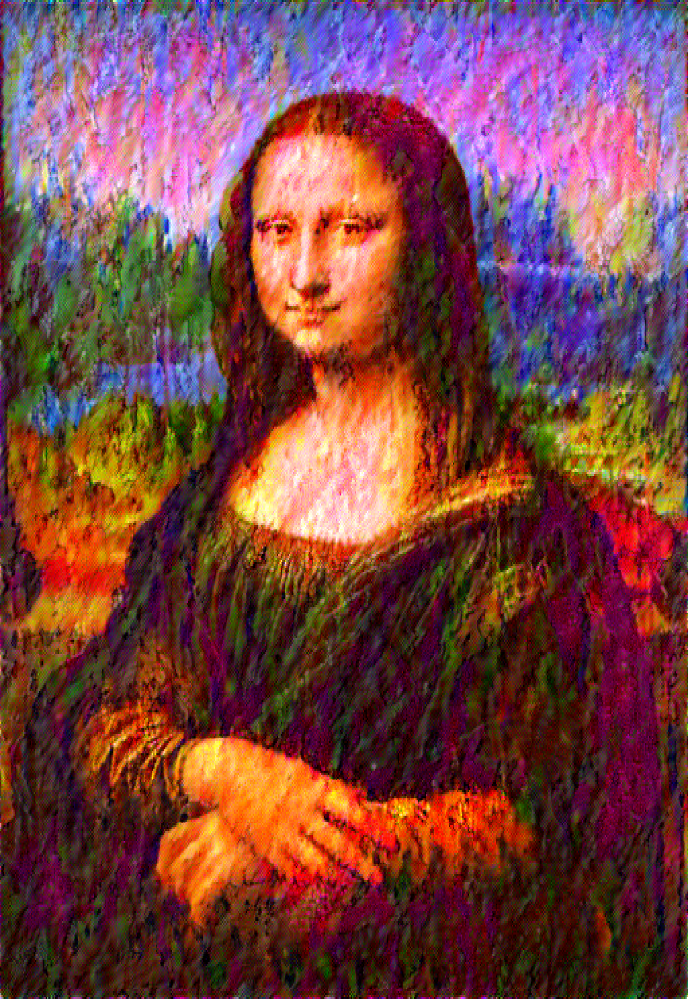

In [44]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

In [47]:
g3 = gen(pic3)
train(g3, pic3, style4, 50000)

tensor(48353972., device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(47021552., device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(44948556., device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(42044536., device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(38489932., device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(34594280., device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(30685318., device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(27083136., device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(23973146., device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(21397484., device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(19250078., device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(17372556., device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(15677500., device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(14133722., device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(12728165., device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(11446296., device='cuda:0', grad_fn=<AddBackward0>) 16
tensor(10281165.,

tensor(49981.4648, device='cuda:0', grad_fn=<AddBackward0>)

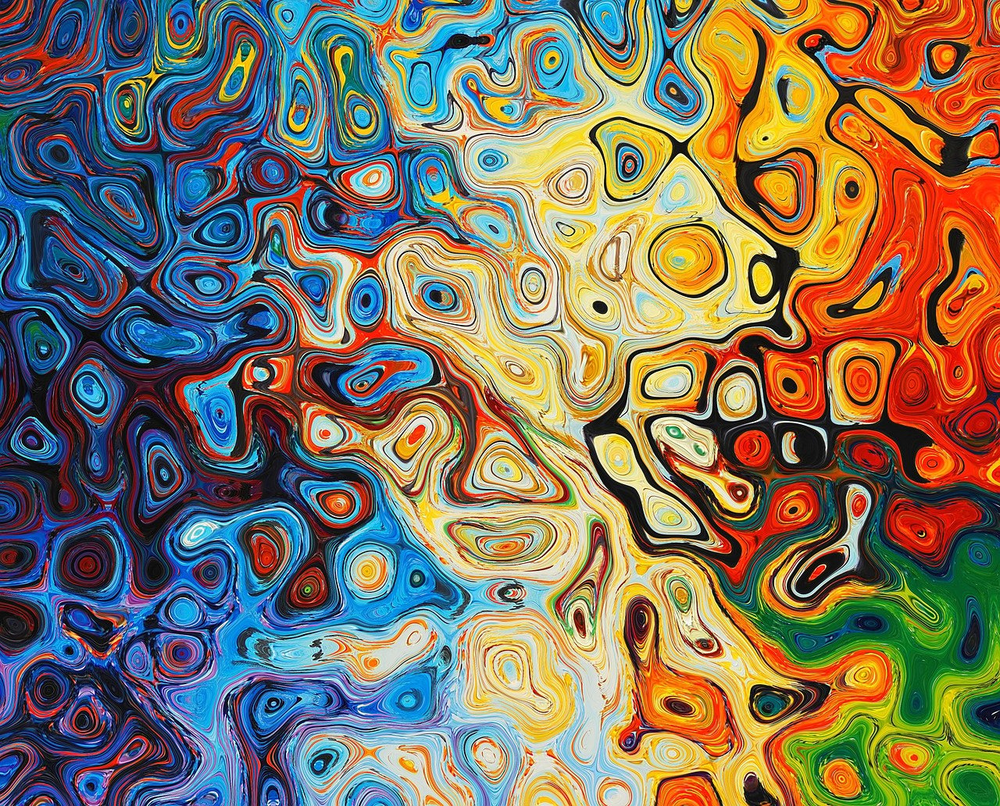

In [49]:
Image.open(r"./drive/My Drive/Colab Notebooks/style4.jpg")

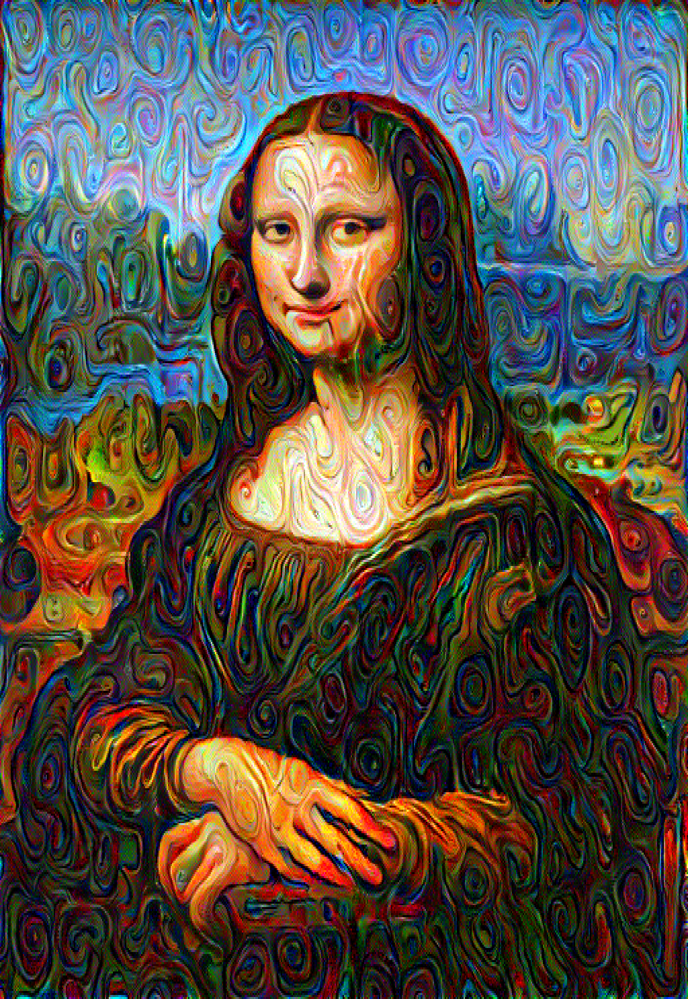

In [50]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new

The above is an instance where losses weren't going below a certain threshold value

In [51]:
g3 = gen(pic3)
train(g3, pic3, style5, 20000)

tensor(2102216.5000, device='cuda:0', grad_fn=<AddBackward0>) 1
tensor(1935198.1250, device='cuda:0', grad_fn=<AddBackward0>) 2
tensor(1783373.6250, device='cuda:0', grad_fn=<AddBackward0>) 3
tensor(1651898.5000, device='cuda:0', grad_fn=<AddBackward0>) 4
tensor(1540988.5000, device='cuda:0', grad_fn=<AddBackward0>) 5
tensor(1463382.5000, device='cuda:0', grad_fn=<AddBackward0>) 6
tensor(1386734.5000, device='cuda:0', grad_fn=<AddBackward0>) 7
tensor(1338914.1250, device='cuda:0', grad_fn=<AddBackward0>) 8
tensor(1262277.7500, device='cuda:0', grad_fn=<AddBackward0>) 9
tensor(1210830.2500, device='cuda:0', grad_fn=<AddBackward0>) 10
tensor(1154402.5000, device='cuda:0', grad_fn=<AddBackward0>) 11
tensor(1120894., device='cuda:0', grad_fn=<AddBackward0>) 12
tensor(1068031.1250, device='cuda:0', grad_fn=<AddBackward0>) 13
tensor(1037184.0625, device='cuda:0', grad_fn=<AddBackward0>) 14
tensor(994243.6875, device='cuda:0', grad_fn=<AddBackward0>) 15
tensor(971508.2500, device='cuda:0', gr

tensor(19675.4355, device='cuda:0', grad_fn=<AddBackward0>)

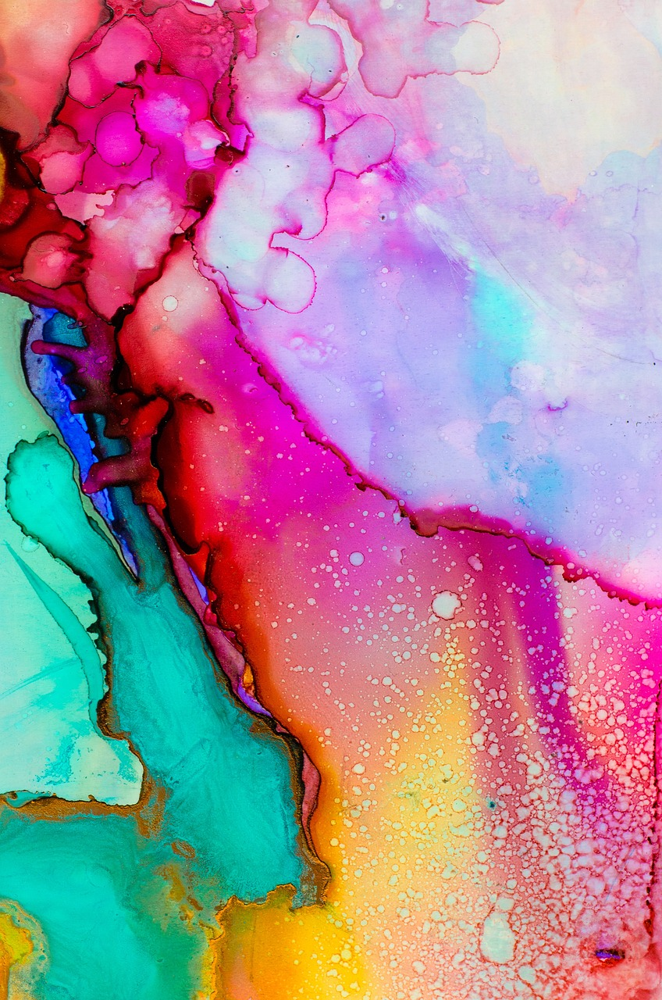

In [53]:
Image.open(r"./drive/My Drive/Colab Notebooks/style5.jpg")

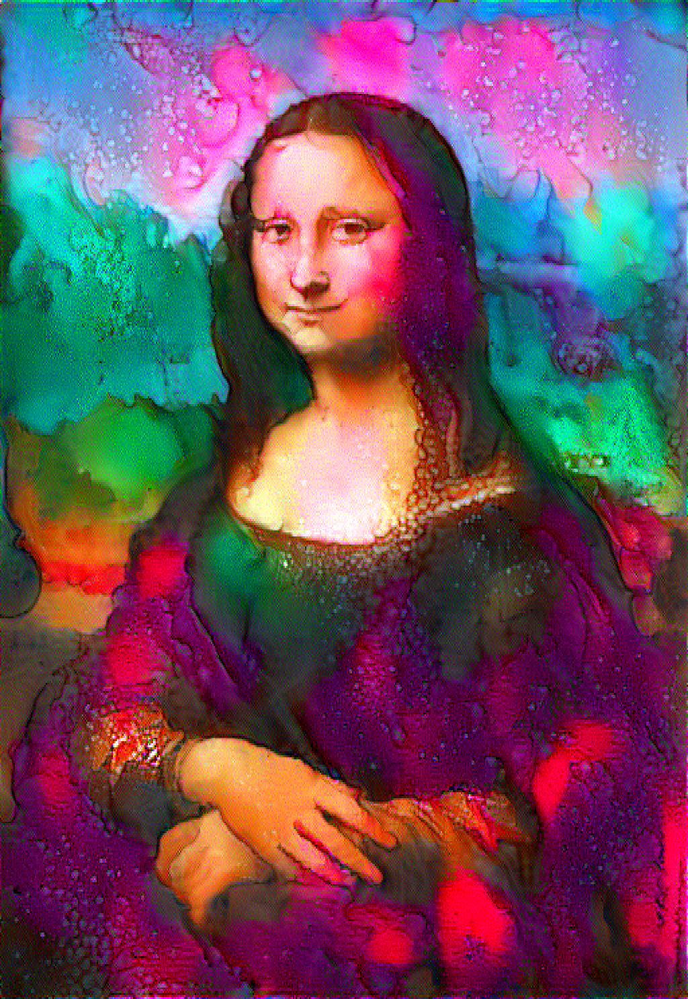

In [54]:
new = Image.open(r"fake.png")
new = new.resize(im.size, resample = 0)
new